In [129]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import numpy as np
from sklearn.manifold import TSNE
from umap.umap_ import UMAP
from pacmap import PaCMAP
from trimap import TRIMAP
import warnings
# Hide warning messages
warnings.filterwarnings('ignore')

# Dataset generation

## Functions that generates different figures

In [2]:
# sphere
def generate_n_dimensional_sphere(num_dimensions, num_points, radius=1):
    
    # Generate normal distributed points.
    points = np.random.randn(num_dimensions, num_points)

    # Normalize the points so that they are on the surface of the sphere.
    points /= np.linalg.norm(points, axis=0)
    
    points *= radius
    return points.T

In [3]:
# ball
def generate_n_dimensional_ball(num_dimensions, num_points, radius=1):

    # Generate points on the surface of the sphere.
    points = np.random.randn(num_dimensions, num_points)
    points /= np.linalg.norm(points, axis=0)

    # Generate a random scaling factor for each point.
    scales = np.random.rand(num_points) ** (1 / num_dimensions)

    # Scale the points by the scaling factors so they are inside the sphere.
    points *= scales * radius

    return points.T

In [4]:
# torus
def generate_n_dimensional_torus(n_dimensions, n_points, R=2, r=1):
    """
    Creates an n-dimensional torus.
    
    Parameters:
    n_dimensions : int
        The number of dimensions for the torus. Must be greater than or equal to 2.
    n_points : int
        The number of points.
    R : float
        The distance from the center of the tube to the center of the torus.
    r : float
        The radius of the tube (distance from the center of the tube to the torus surface).
        
    Returns:
    numpy.ndarray
        The n-dimensional points of the torus.
    """
    
    assert n_dimensions >= 2, "Number of dimensions must be greater than or equal to 2."

    # generate n_points random angles for each dimension
    angles = np.random.uniform(0, 2*np.pi, (n_points, n_dimensions))

    # calculate the n-dimensional points on the torus
    coordinates = []
    for i in range(n_dimensions):
        if i == 0:
            coordinate = (R + r * np.cos(angles[:, 1])) * np.cos(angles[:, 0])
        elif i == 1:
            coordinate = (R + r * np.cos(angles[:, 1])) * np.sin(angles[:, 0])
        else:
            coordinate = r * np.sin(angles[:, i])
        coordinates.append(coordinate)

    return np.array(coordinates).T


In [141]:
# ball in sphere in sphere
def generate_ball_in_sphere_in_sphere(num_dimensions, num_points, radii=[1, 50, 100]):
    
    ball_1 = generate_n_dimensional_ball(num_dimensions, num_points, radii[0])
    sphere_1 = generate_n_dimensional_sphere(num_dimensions, num_points, radii[1])
    sphere_2 = generate_n_dimensional_sphere(num_dimensions, num_points, radii[2])
    
    # Create labels for each figure
    ball_1_labels = np.full((num_points,), 'ball')
    sphere_1_labels = np.full((num_points,), 'sphere 1')
    sphere_2_labels = np.full((num_points,), 'sphere 2')
    
    # Concatenate data and labels
    data = np.concatenate((ball_1, sphere_1, sphere_2))
    labels = np.concatenate((ball_1_labels, sphere_1_labels, sphere_2_labels))
    
    return data, labels

In [143]:
# torus in sphere
def generate_torus_in_sphere(num_dimensions, num_points, radii=[5, 50, 100]):
    
    torus = generate_n_dimensional_torus(num_dimensions, num_points, radii[1], radii[0])
    sphere = generate_n_dimensional_sphere(num_dimensions, num_points, radii[2])

     # Create labels for each figure
    torus_labels = np.full((num_points,), 'torus')
    sphere_labels = np.full((num_points,), 'sphere')
    
    # Concatenate data and labels
    data = np.concatenate((torus, sphere))
    labels = np.concatenate((torus_labels, sphere_labels))
    
    return data, labels

In [258]:
# generate 2D array of datasets with different number of dimensions and datasize
# variable type_of_dataset tells which type of dataset should be created
# size of the 2D array is data_size X num_of_dimensions
def generate_datasets(number_of_dimensions, data_size, type_of_dataset):
    # create an empty 2D array to store the datasets
    datasets = np.empty((len(data_size), len(number_of_dimensions)), dtype=object)
    labels = np.empty((len(data_size), len(number_of_dimensions)), dtype=object)
    # 1 means first ddataset - ball in sphere in sphere
    if type_of_dataset == 1:
        for i, size in enumerate(data_size):
            for j, dim in enumerate(number_of_dimensions):
                dataset, label = generate_ball_in_sphere_in_sphere(dim, size)
                datasets[i, j] = dataset
                labels[i, j] = label
     # 2 means second ddataset - torus in sphere
    elif type_of_dataset == 2:
        for i, size in enumerate(data_size):
            for j, dim in enumerate(number_of_dimensions):
                dataset, label = generate_torus_in_sphere(dim, size)
                datasets[i, j] = dataset
                labels[i, j] = label
    else: 
        return None
    return datasets, labels

## Functions to visualise figures

In [98]:
# visualisation of 3d figures
# one color
def visualize_3d_figure(points, title='3 dimensional points'):

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(points[:, 0], points[:, 1], points[:, 2])

    # Set the same scale for all axes
    max_range = np.array([points[:, 0].max()-points[:, 0].min(), points[:, 1].max()-points[:, 1].min(), points[:, 2].max()-points[:, 2].min()]).max()
    Xb = 0.5*max_range*np.mgrid[-1:2:2,-1:2:2,-1:2:2][0].flatten() + 0.5*(points[:, 0].max()+points[:, 0].min())
    Yb = 0.5*max_range*np.mgrid[-1:2:2,-1:2:2,-1:2:2][1].flatten() + 0.5*(points[:, 1].max()+points[:, 1].min())
    Zb = 0.5*max_range*np.mgrid[-1:2:2,-1:2:2,-1:2:2][2].flatten() + 0.5*(points[:, 2].max()+points[:, 2].min())

    # Comment or uncomment following both lines to test the fake bounding box:
    for xb, yb, zb in zip(Xb, Yb, Zb):
        ax.plot([xb], [yb], [zb], 'w')

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')

    plt.show()


In [99]:
# visualisation of 3d figures in figures
# two color
def visualize_3d_figure_in_figure(points, title='3 dimensional points'):
    n = int(points.shape[0] / 3)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter3D(points[:n, 0], points[:n, 1], points[:n, 2])
    ax.scatter3D(points[-n:, 0], points[-n:, 1], points[-n:, 2], color = 'pink', alpha = 0.3)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title(title)
    
    plt.show()

In [100]:
# visualisation of 3d figure in figure in figure
# three colors
def visualize_3d_figure_in_figure_in_figure(points, title='3 dimensional points'):
    n = int(points.shape[0] / 3)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter3D(points[:n, 0], points[:n, 1], points[:n, 2])
    ax.scatter3D(points[n:-n, 0], points[n:-n, 1], points[n:-n, 2], color = 'green', alpha = 0.3)
    ax.scatter3D(points[-n:, 0], points[-n:, 1], points[-n:, 2], color = 'pink', alpha = 0.3)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title(title)
    
    plt.show()


## Generation of different variances of datasets

In [248]:
number_of_dimensions = [3, 5, 10, 15]
number_of_points = [1000, 5000, 10000, 50000]

In [259]:
# generation of array of datasets with labels: ball in sphere in sphere with different number of dimensions and number of points
datasets_1, labels_1 = generate_datasets(number_of_dimensions, number_of_points, 1)

# generation of array of datasets: torus in sphere in sphere with different number of dimensions and number of points
datasets_2, labels_2 = generate_datasets(number_of_dimensions, number_of_points, 2)


In [260]:
d, l = generate_datasets(number_of_dimensions, number_of_points, 2)

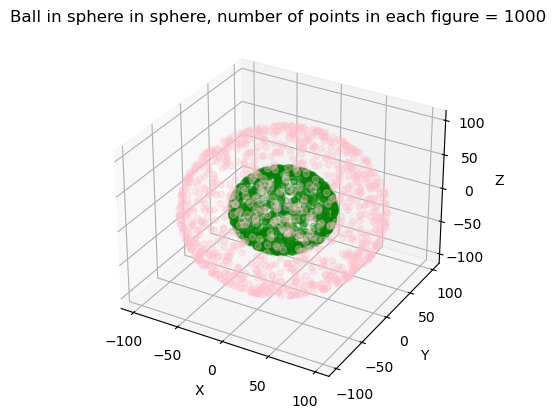

In [242]:
visualize_3d_figure_in_figure_in_figure(datasets_1[0, 0], title='Ball in sphere in sphere, number of points in each figure = 1000')

In [253]:
visualize_3d_figure_in_figure(datasets_2[0, 0], title='Torus in sphere, number of points in each figure = 1000')

AttributeError: 'tuple' object has no attribute 'shape'

# Functions of algorithms that reduces dimensionality

In [230]:
def tsne_visualisation(points, labels, title='TSNE'):
    
    # Apply t-SNE for dimensionality reduction
    tsne = TSNE()
    reduced_points = tsne.fit_transform(points)
    
    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels,  legend = 'full')
    plt.xlabel('t-SNE Dimension 1', fontsize = 14)
    plt.ylabel('t-SNE Dimension 2', fontsize= 14)
    plt.title(title, fontsize = 18)

In [231]:
def umap_visualisation(points, labels, title = 'UMAP'):
    
    # Apply t-SNE for dimensionality reduction
    umap = UMAP()
    reduced_points = umap.fit_transform(points)

    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels, legend = 'full')
    plt.xlabel('UMAP Dimension 1',fontsize = 14)
    plt.ylabel('UMAP Dimension 2',fontsize= 14)
    plt.title(title, fontsize = 18)
    

In [232]:
def trimap_visualisation(points, labels, title = 'PaCMAP'):
    
    # Apply TriMAP for dimensionality reduction
    trimap = TRIMAP()
    reduced_points = trimap.fit_transform(points)
    
    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels, legend = 'full')
    plt.xlabel('TriMAP Dimension 1', fontsize = 14)
    plt.ylabel('TriMAP Dimension 2', fontsize= 14)
    plt.title(title, fontsize = 18)

In [233]:
def pacmap_visualisation(points, labels, title = 'PaCMAP'):
    
    # Apply PaCMAP for dimensionality reduction
    pacmap = PaCMAP()
    reduced_points = pacmap.fit_transform(points)
    
    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels,  legend = 'full')
    plt.xlabel('PaCMAP Dimension 1', fontsize = 14)
    plt.ylabel('PaCMAP Dimension 2', fontsize = 14)
    plt.title(title, fontsize = 18)

In [234]:
def ivhd_visualisation(points, title = 'IVHD'):
    pass

In [254]:
# matrix plot visualisation on one plot with different parameters od datasize and dimensionality
# y axis is data size
# x axis i dimensionality
def matrix_plot_visualisation(datasets, labels, dimensionality_reduction_func, plot_title):
    plt.subplots(figsize=(30, 30))
    plt.subplots_adjust(hspace=0.3, wspace=0.3) 
    k = 0
    num_rows = datasets.shape[0]
    num_cols = datasets.shape[1]

    for i in range(num_rows):
        for j in range(num_cols):
            dataset = datasets[i][j]
            label = labels[i][j]
            k+=1
            plt.subplot(num_rows, num_cols, k)
            dimensionality_reduction_func(dataset, label, title = "Number of points: " + str(dataset.shape[0]) + "\n Number of dimensions: " + str(dataset.shape[1]))
            
    plt.suptitle(plot_title, fontsize = 40)

# Implementing dimensionality reduction allgorithms on datasets

## Dataset 0

Redukcja wymiarów na podstawowych figurach
Do wywalenia potem, tlyko tak podglądowo

## Sphere

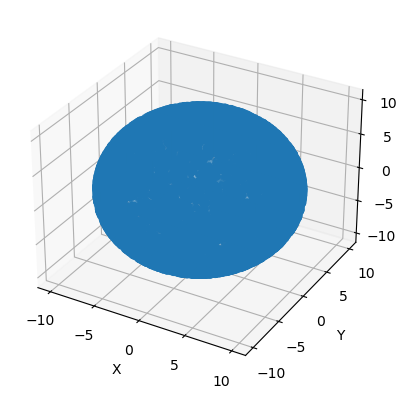

In [112]:
sphere = generate_n_dimensional_sphere(3, 10000, 10)
visualize_3d_figure(sphere, title = '3 dimensional sphere, number of points = 1000')

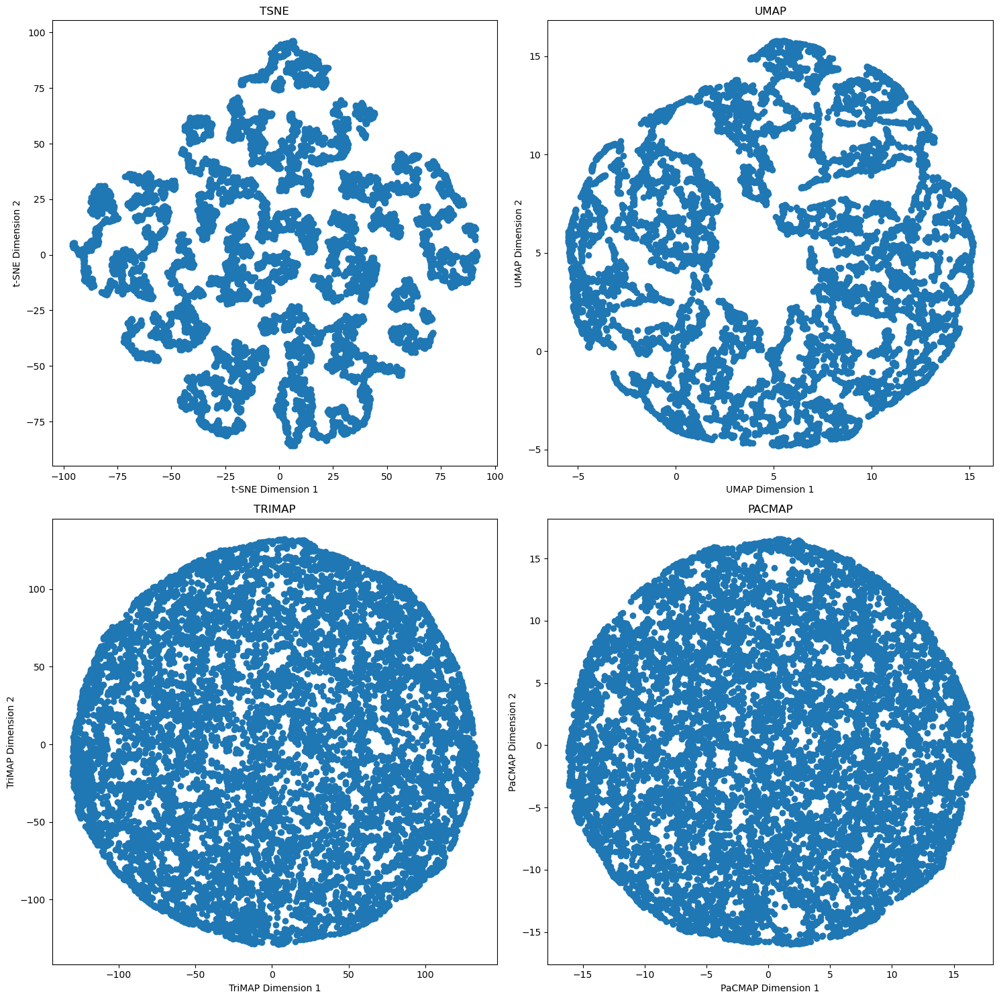

In [113]:
plt.subplots(figsize=(15, 15))
plt.subplot(2, 2, 1)
tsne_visualisation(sphere, title='TSNE')
plt.subplot(2, 2, 2)
umap_visualisation(sphere, title='UMAP')
plt.subplot(2, 2, 3)
trimap_visualisation(sphere, title='TRIMAP')
plt.subplot(2, 2, 4)
pacmap_visualisation(sphere, title='PACMAP')

plt.tight_layout()
plt.show()

## Ball

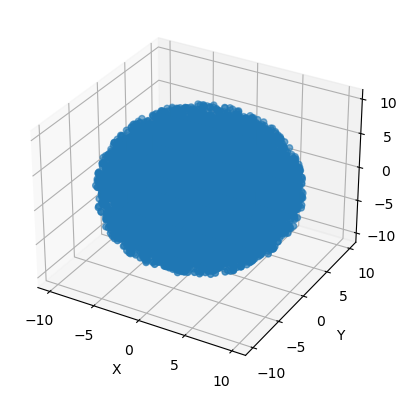

In [114]:
ball = generate_n_dimensional_ball(3, 10000, 10)
visualize_3d_figure(ball, title = '3 dimensional ball, number of points = 1000')

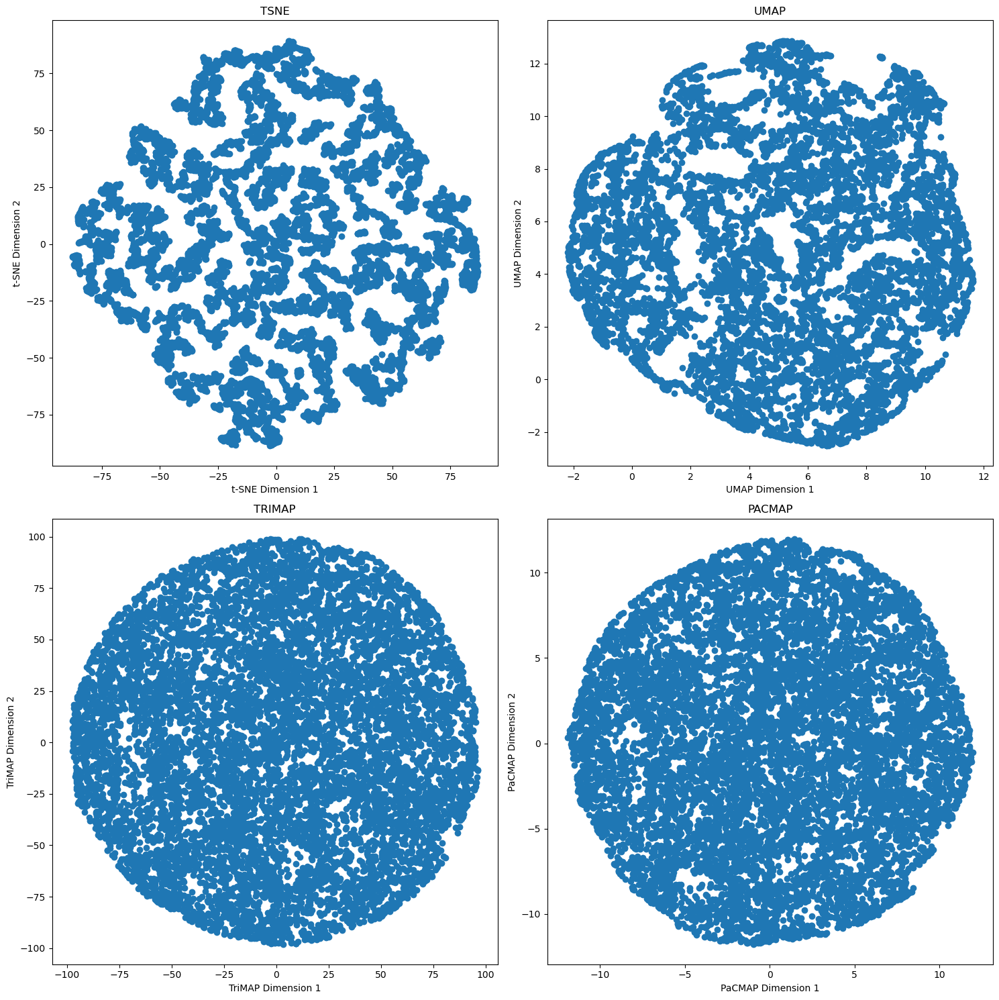

In [115]:
plt.subplots(figsize=(15, 15))
plt.subplot(2, 2, 1)
tsne_visualisation(ball, title='TSNE')
plt.subplot(2, 2, 2)
umap_visualisation(ball, title='UMAP')
plt.subplot(2, 2, 3)
trimap_visualisation(ball, title='TRIMAP')
plt.subplot(2, 2, 4)
pacmap_visualisation(ball, title='PACMAP')

plt.tight_layout()
plt.show()

Miedzy kulą a sfera nie ma jakiejs duzej roznicy w wizualizacji

## Torus

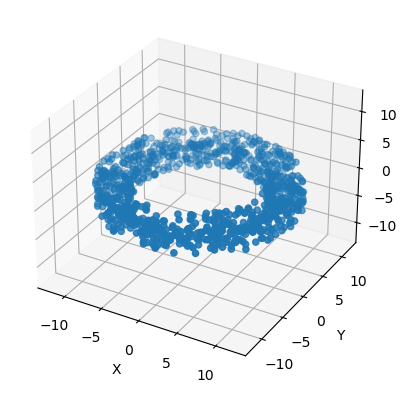

In [119]:
torus = generate_n_dimensional_torus(3, 1000, 10, 2)
visualize_3d_figure(torus, title = '3 dimensional torus, number of points = 1000')

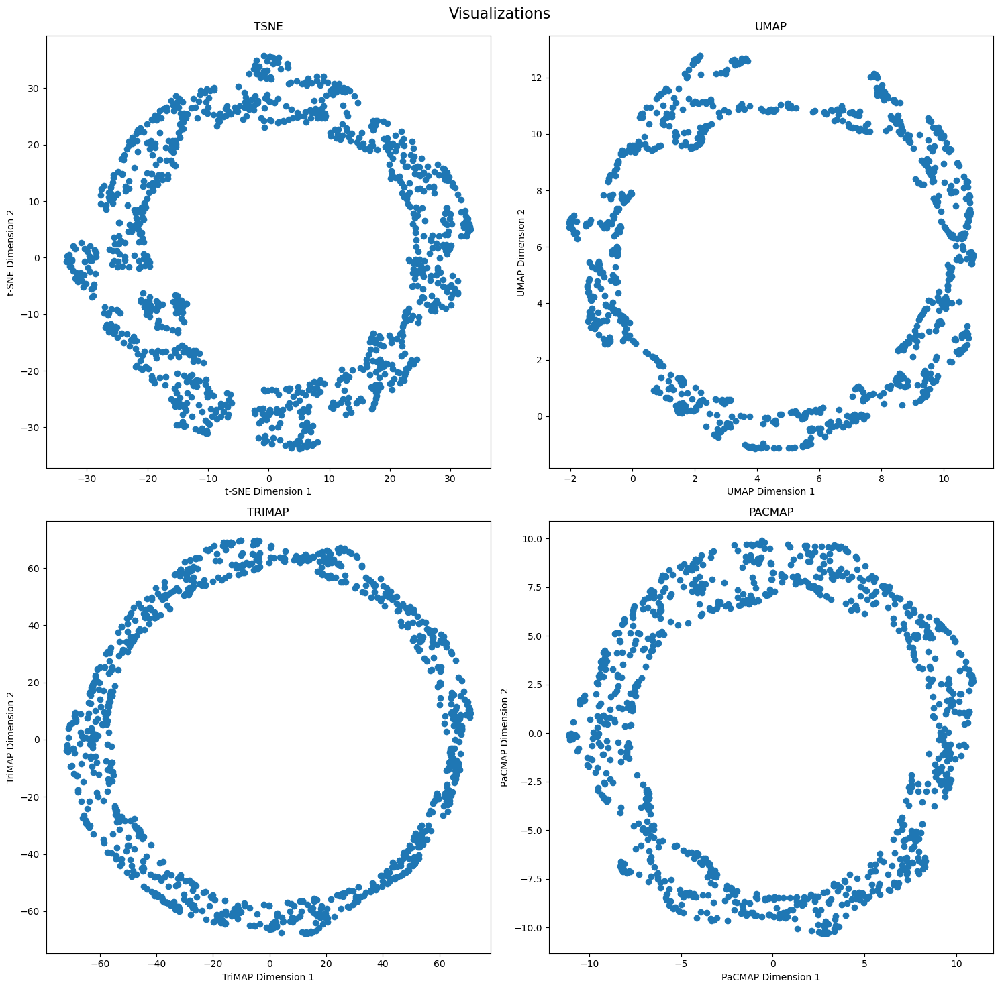

In [121]:
plt.subplots(figsize=(15, 15))
plt.subplot(2, 2, 1)
tsne_visualisation(torus, title='TSNE')
plt.subplot(2, 2, 2)
umap_visualisation(torus, title='UMAP')
plt.subplot(2, 2, 3)
trimap_visualisation(torus, title='TRIMAP')
plt.subplot(2, 2, 4)
pacmap_visualisation(torus, title='PACMAP')
plt.suptitle('Visualizations', fontsize = 16)
plt.tight_layout()
plt.show()

## Dataset 1 - Ball in sphere in sphere

### TSNE

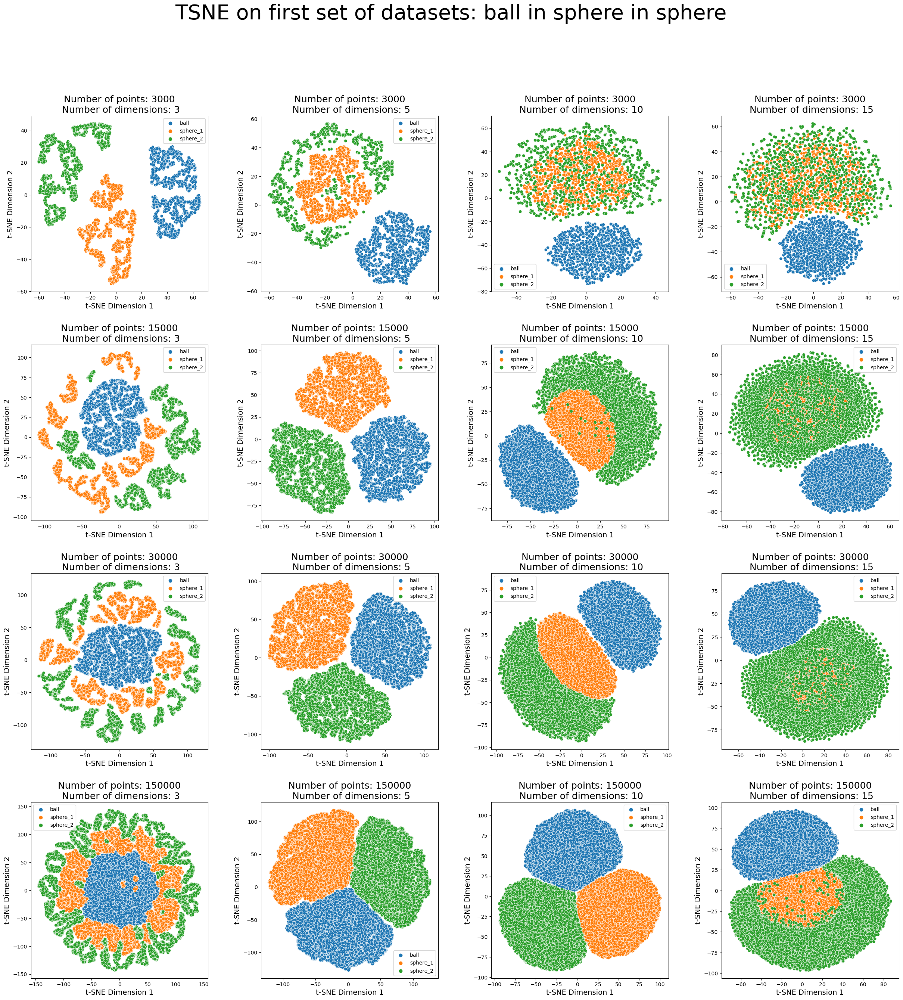

In [243]:
matrix_plot_visualisation(datasets_1, labels_1, tsne_visualisation, "TSNE on first set of datasets: ball in sphere in sphere")

### UMAP

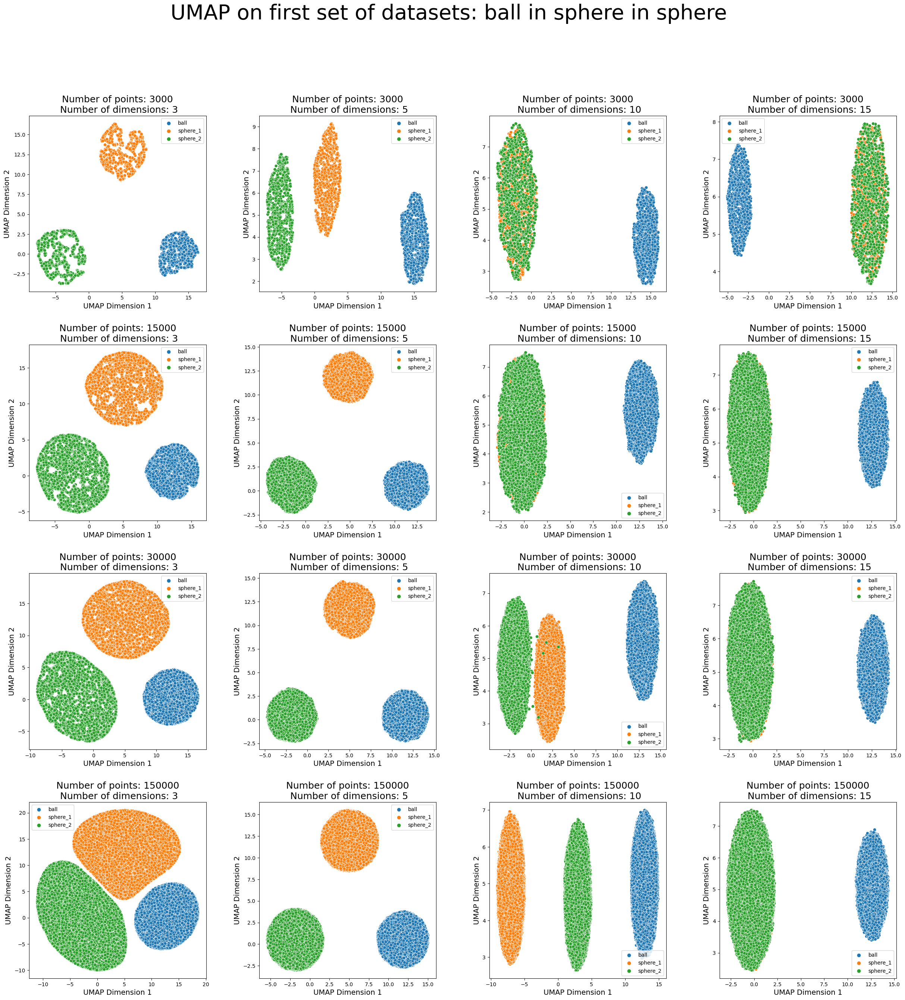

In [244]:
matrix_plot_visualisation(datasets_1, labels_1, umap_visualisation, "UMAP on first set of datasets: ball in sphere in sphere")

### TriMAP

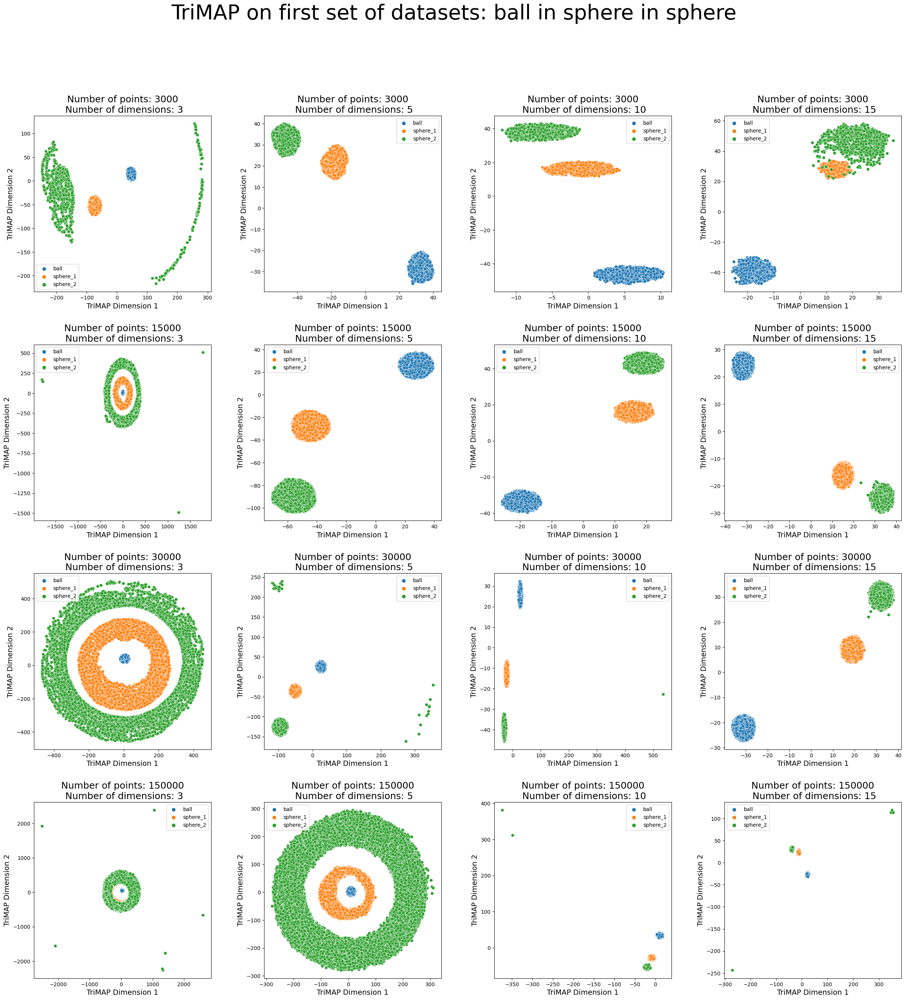

In [245]:
matrix_plot_visualisation(datasets_1, labels_1, trimap_visualisation, "TriMAP on first set of datasets: ball in sphere in sphere")

### PaCMAP

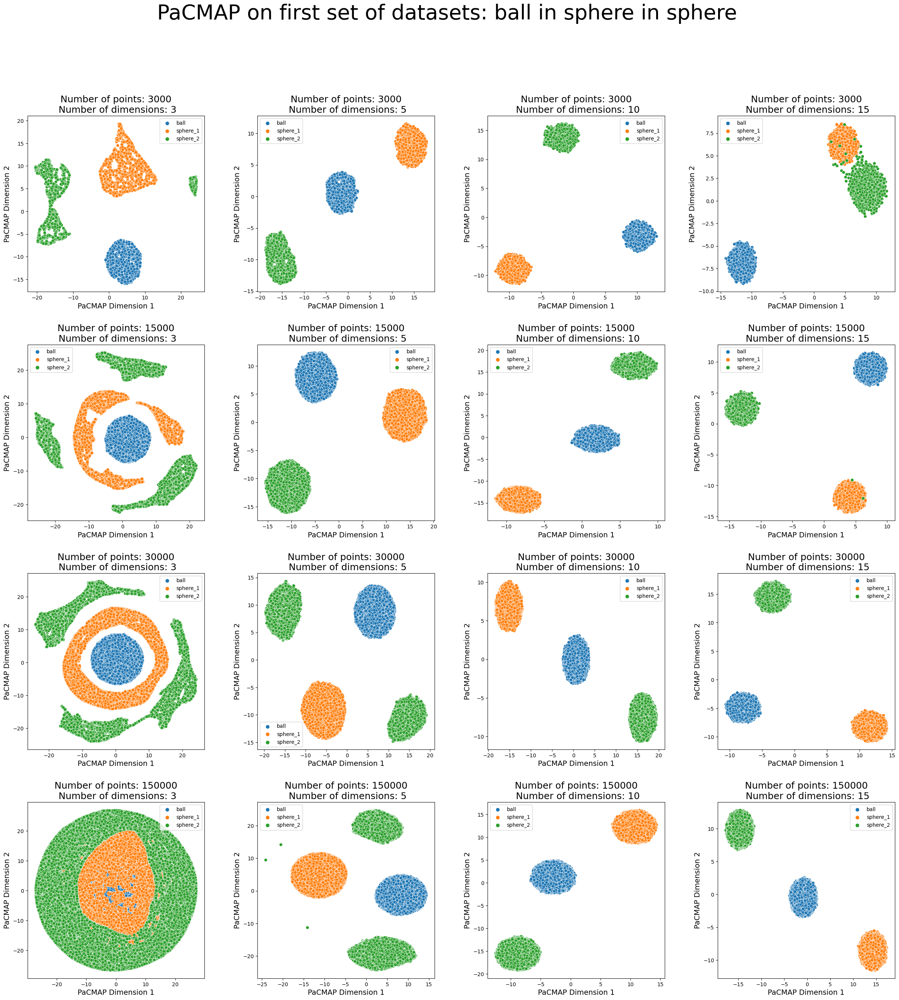

In [246]:
matrix_plot_visualisation(datasets_1, labels_1, pacmap_visualisation, "PaCMAP on first set of datasets: ball in sphere in sphere")

## Dataset 2 - Torus in sphere

### TSNE

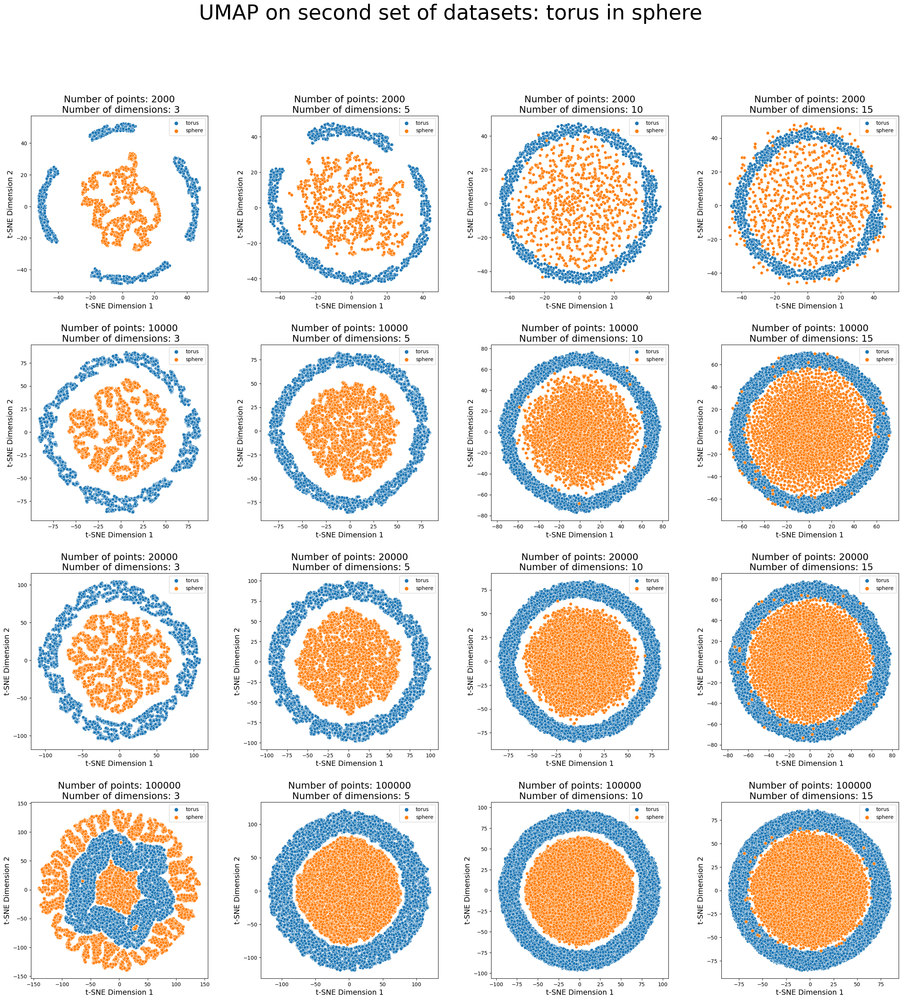

In [261]:
matrix_plot_visualisation(datasets_2, labels_2, tsne_visualisation, "UMAP on second set of datasets: torus in sphere")

### UMAP

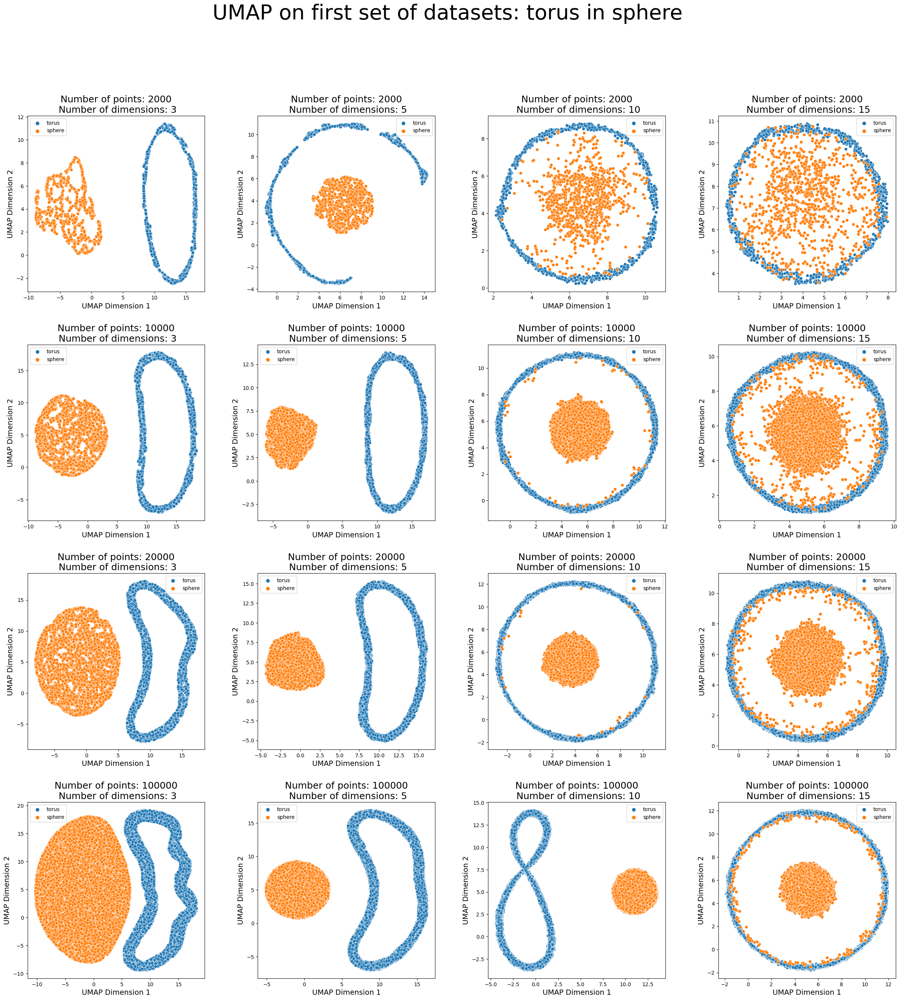

In [262]:
matrix_plot_visualisation(datasets_2, labels_2, umap_visualisation, "UMAP on first set of datasets: torus in sphere")

### TriMAP

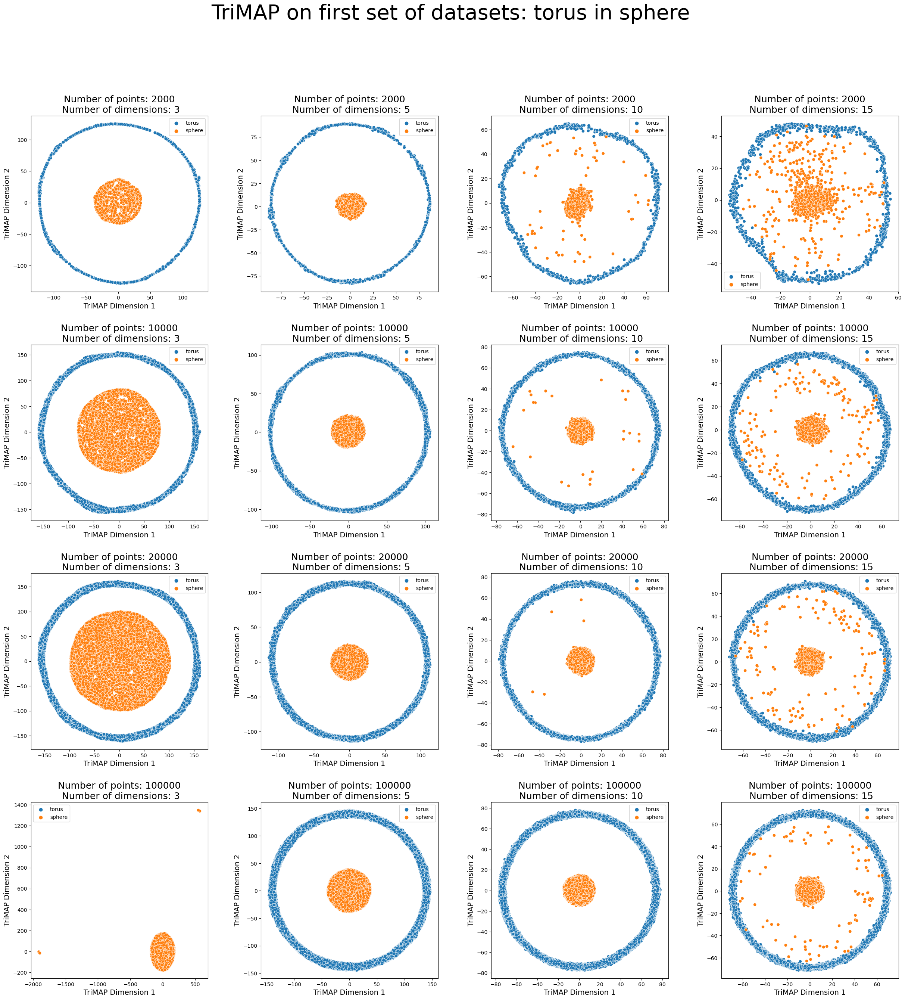

In [263]:
matrix_plot_visualisation(datasets_2, labels_2, trimap_visualisation, "TriMAP on first set of datasets: torus in sphere")

### PaCMAP

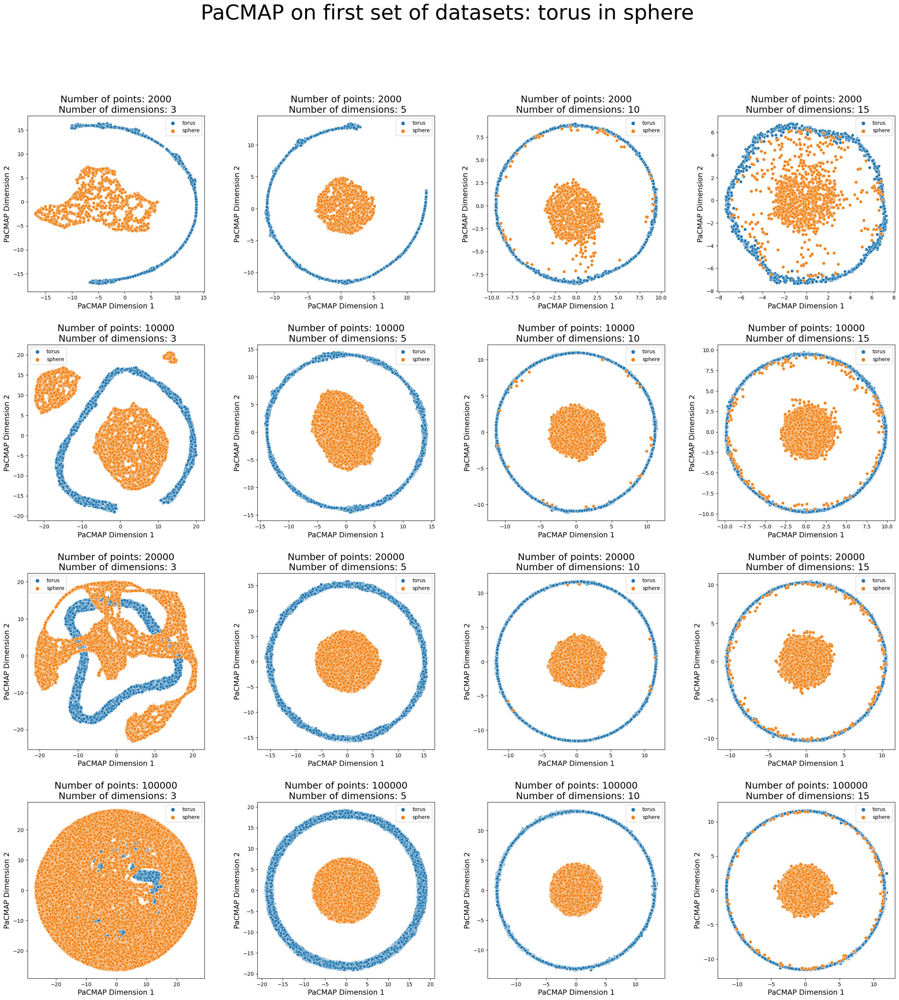

In [264]:
matrix_plot_visualisation(datasets_2, labels_2, pacmap_visualisation, "PaCMAP on first set of datasets: torus in sphere")

Wnioski: <br/>
+ Znowu jest tak że dla 300000 punktow dla mniejszej wymairowości radzi sobie gorzje

## TO DO
- dodać ivhd
- pobawić sie parametrami
- dodać kolejną figure
- przetestowac jak sobie radza te algorytmy za pomoca metryk